<a href="https://colab.research.google.com/github/AlvarFeher/AdventOfCode22/blob/main/Copy_of_Clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import matplotlib.pyplot as plt
import networkx as nx

In [2]:
from google.colab import drive
drive.mount('/content/drive')
filename = "/content/drive/MyDrive/TFG/data/filtered_data_good.pkl"
!pip install awkward pandas awkward-pandas

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import pandas as pd
import pickle
import networkx as nx

# Cargar el dataset
with open(filename, 'rb') as file:
    filtered_df = pickle.load(file)

# Asegurar que las columnas sean listas de Python si vienen en awkward arrays
filtered_df['digitE'] = filtered_df['digitE'].apply(lambda x: x[0] if isinstance(x, list) else x)
filtered_df['digitR'] = filtered_df['digitR'].apply(lambda x: x[0] if isinstance(x, list) else x)
filtered_df['digitC'] = filtered_df['digitC'].apply(lambda x: x[0] if isinstance(x, list) else x)
filtered_df['MCID'] = filtered_df['MCID'].apply(lambda x: x[0] if isinstance(x, list) else x)

# Ahora estamos incluyendo TODAS las partículas, sin filtrar solo fotones
particles = filtered_df.copy()

print(f"Total de particulas en el dataset: {len(particles)}")
print("Ejemplo de datos:")
print(particles.head())


Total de particulas en el dataset: 13615740
Ejemplo de datos:
                            evtnum  digitE  digitR  digitC   MCID       MCP
entry subentry subsubentry                                                 
0     0        0            303626   5.538    12.0     2.0  130.0  4.110076
               1            303626   5.538    12.0     2.0  130.0  4.110076
               2            303626   5.538    12.0     2.0  130.0  4.110076
               3            303626   5.538    12.0     2.0  130.0  4.110076
               4            303626   5.538    12.0     2.0  130.0  4.110076


In [4]:
photon_counts_per_event = filtered_df[filtered_df["MCID"] == 22].groupby("evtnum").size().reset_index(name="Photon Count")
photon_counts_per_event.sort_values(by="Photon Count", ascending=False, inplace=True)
print("Photon counts per event:")
print(photon_counts_per_event.head())
print("Total de eventos")
print(len(photon_counts_per_event))

Photon counts per event:
      evtnum  Photon Count
16     42367          2070
3238  297225          1950
1423  234384          1950
2637  276050          1920
1881  255595          1920
Total de eventos
3536


In [5]:
photon_counts_per_event = filtered_df[filtered_df["MCID"] == 22].groupby("evtnum").size().reset_index(name="Photon Count")

# Select an event with the highest number of photons
example_event_id = photon_counts_per_event.sort_values(by="Photon Count", ascending=False).iloc[0]["evtnum"]


particles = filtered_df[filtered_df["evtnum"] == example_event_id] # we are using the event with the biggest amount of photons!
particles.head()

example_event = photon_counts_per_event.sort_values(by="Photon Count", ascending=False).iloc[0]
example_event_id = example_event["evtnum"]
num_photons_in_event = example_event["Photon Count"]

print(f"Event {example_event_id} has {num_photons_in_event} photons.")

Event 42367 has 2070 photons.


In [6]:
#particles = filtered_df.sample(frac=0.1, random_state=42)
#print(f"Reduced dataset size: {len(particles)}")

### Finding seeds using the 50 MeV threshold in a 3x3 cell area

In [82]:
import numpy as np

energy_threshold = 50  # Umbral para considerar un seed
seeds = []
particles = particles.reset_index(drop=True)

for index, row in particles.iterrows():
    r, c, e = row['digitR'], row['digitC'], row['digitE']

    # Encontrar los vecinos en la malla
    neighbors = particles[(abs(particles['digitR'] - r) <= 1) & (abs(particles['digitC'] - c) <= 1)]

    # Si el nodo es el de mayor energía en su vecindad y supera el umbral, es un seed
    if e == neighbors['digitE'].max() and e > energy_threshold:
        seeds.append((index, r, c, e, row['MCID']))  # Guardamos ID de partícula también

# Ordenar por energía descendente
seeds = sorted(seeds, key=lambda x: -x[3])

print(f"Total de seeds identificados: {len(seeds)}")
print("Ejemplo de seeds:", seeds[:5])



Total de seeds identificados: 1110
Ejemplo de seeds: [(4860, 36.0, 0.0, 6113.748046875, 321.0), (4861, 36.0, 0.0, 6113.748046875, 321.0), (4862, 36.0, 0.0, 6113.748046875, 321.0), (4863, 36.0, 0.0, 6113.748046875, 321.0), (4864, 36.0, 0.0, 6113.748046875, 321.0)]


In [7]:
G = nx.DiGraph()

# adding seeds
for seed in seeds:
    idx, r, c, energy, mcid = seed
    G.add_node(idx, row=r, column=c, energy=energy, type='seed', MCID=mcid)

# adding neighbours to the closest seed
for index, row in particles.iterrows():
    r, c, e = row['digitR'], row['digitC'], row['digitE']
    if index in [s[0] for s in seeds]:  # If it is a seed we dont consider it
        continue

    # look for closest seed
    closest_seed = min(seeds, key=lambda s: abs(s[1] - r) + abs(s[2] - c))  # Manhattan Distance
    seed_idx, sr, sc, s_energy, s_mcid = closest_seed

    # add node and connect to closest seed
    G.add_node(index, row=r, column=c, energy=e, type='neighbor', MCID=row['MCID'])
    G.add_edge(index, seed_idx, weight=e / s_energy)  # weight is the % of energy that it gives to the seed

print(f"Graph has {G.number_of_nodes()} nodes and {G.number_of_edges()} edges")


Graph has 10770 nodes and 9660 edges


### Download graph

In [9]:
#with open("/content/graph.pkl", "wb") as f:
 #   pickle.dump(G, f)
#files.download("/content/graph.pkl")

## Looking for weekly connected components:

- How do we identify a cluster? By checking weekly directed components!

### What is a weekly directed component?

Weekly connected components in a directed graph are those that are related and, ignoring their edge directions, exists a path between each pair of nodes.

A -> B -> C <- D  ::  A -- B -- C -- D

A strongly connected component requires a bidirectional connection between nodes, and that cant happen because the graph is created by connecting neighbors to their seed: N -> S


Resumen de Clusters:
<bound method NDFrame.head of       Cluster ID  Cluster Size  Seed MCID  Seed Energy  Dominant MCID  \
0              0           181      321.0  6113.748047           22.0   
1              1             1      321.0  6113.748047          321.0   
2              2             1      321.0  6113.748047          321.0   
3              3             1      321.0  6113.748047          321.0   
4              4             1      321.0  6113.748047          321.0   
...          ...           ...        ...          ...            ...   
1105        1105             1     -321.0   194.832001         -321.0   
1106        1106             1     -321.0   194.832001         -321.0   
1107        1107             1     -321.0   194.832001         -321.0   
1108        1108             1     -321.0   194.832001         -321.0   
1109        1109             1     -321.0   194.832001         -321.0   

      Dominant Energy  
0        45774.599304  
1         6113.748047  


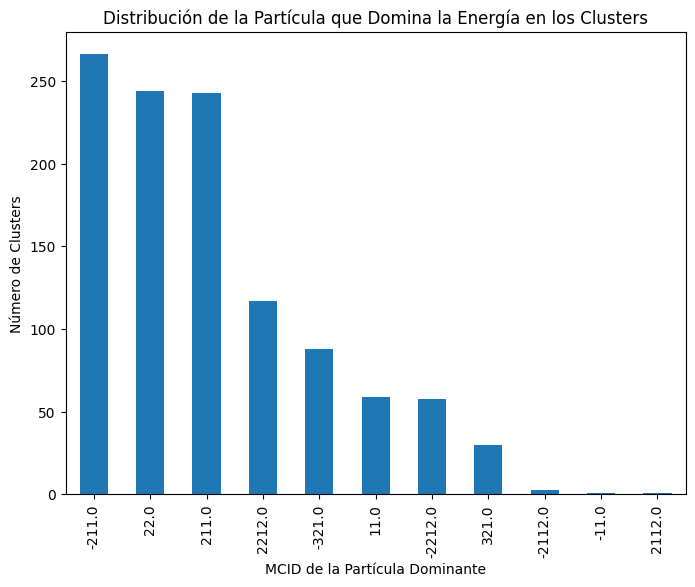

In [8]:
from ctypes import sizeof
import networkx as nx
import pandas as pd
import json
import matplotlib.pyplot as plt

# Identificar clusters como componentes conectadas
clusters = list(nx.weakly_connected_components(G))

# Almacenar resultados
cluster_analysis = []
clustered_nodes = {}  # Dictionary to store nodes grouped by cluster
node_cluster_mapping = {}
for cluster_id, cluster in enumerate(clusters):
    cluster_nodes = list(cluster)

    # Separar seeds y vecinos
    seeds = [node for node in cluster_nodes if G.nodes[node]['type'] == 'seed']
    neighbors = [node for node in cluster_nodes if G.nodes[node]['type'] == 'neighbor']

    # Solo debe haber 1 seed por cluster
    if len(seeds) != 1:
        continue  # Omitir si no cumple la condición

    seed_id = seeds[0]
    seed_mcid = G.nodes[seed_id]['MCID']
    seed_energy = G.nodes[seed_id]['energy']

    # Sumar energía por tipo de partícula
    energy_by_particle = {}
    for node in cluster_nodes:
        mcid = G.nodes[node]['MCID']
        energy = G.nodes[node]['energy']
        energy_by_particle[mcid] = energy_by_particle.get(mcid, 0) + energy

    # Ordenar partículas por energía
    dominant_particle = max(energy_by_particle, key=energy_by_particle.get)

    # Store nodes in a structured way
    clustered_nodes[cluster_id] = [
        {
            'node_id': node,
            'energy': G.nodes[node]['energy'],
            'MCID': G.nodes[node]['MCID'],
            'type': G.nodes[node]['type'],
            'row': G.nodes[node]['row'],
            'column': G.nodes[node]['column'],
            'clusterId': cluster_id
        } for node in cluster_nodes
    ]

    cluster_analysis.append({
        'Cluster ID': cluster_id,
        'Cluster Size': len(cluster_nodes),
        'Seed MCID': seed_mcid,
        'Seed Energy': seed_energy,
        'Dominant MCID': dominant_particle,
        'Dominant Energy': energy_by_particle[dominant_particle]
    })

# Convertir en DataFrame para análisis
df_clusters = pd.DataFrame(cluster_analysis)
print("Resumen de Clusters:")
print(df_clusters.head)

# Save node-cluster mapping to a DataFrame
node_cluster_df = pd.DataFrame.from_dict(node_cluster_mapping, orient='index', columns=['cluster_id'])
node_cluster_df.reset_index(inplace=True)
node_cluster_df.rename(columns={'index': 'node_id'}, inplace=True)

# Save the updated dataset with cluster IDs
output_json_path = "nodes_with_cluster_ids.json"
node_cluster_df.to_json(output_json_path, orient="records", indent=4)
print(f"Dataset with nodes and cluster IDs saved to {output_json_path}")

# Visualización de distribución de partículas dominantes
plt.figure(figsize=(8, 6))
df_clusters['Dominant MCID'].value_counts().plot(kind='bar')
plt.xlabel('MCID de la Partícula Dominante')
plt.ylabel('Número de Clusters')
plt.title('Distribución de la Partícula que Domina la Energía en los Clusters')
plt.show()




In [11]:
clustered_nodes


{0: [{'node_id': (1439, 186, 12),
   'energy': 65.01000213623047,
   'MCID': -211.0,
   'type': 'neighbor',
   'row': 39.0,
   'column': 0.0,
   'clusterId': 0},
  {'node_id': (1439, 154, 23),
   'energy': 646.64599609375,
   'MCID': 22.0,
   'type': 'neighbor',
   'row': 35.0,
   'column': 0.0,
   'clusterId': 0},
  {'node_id': (1439, 178, 8),
   'energy': 25.739999771118164,
   'MCID': -2112.0,
   'type': 'neighbor',
   'row': 38.0,
   'column': 0.0,
   'clusterId': 0},
  {'node_id': (1439, 186, 21),
   'energy': 65.01000213623047,
   'MCID': -211.0,
   'type': 'neighbor',
   'row': 39.0,
   'column': 0.0,
   'clusterId': 0},
  {'node_id': (1439, 178, 17),
   'energy': 25.739999771118164,
   'MCID': -2112.0,
   'type': 'neighbor',
   'row': 38.0,
   'column': 0.0,
   'clusterId': 0},
  {'node_id': (1439, 170, 13),
   'energy': 811.9199829101562,
   'MCID': 22.0,
   'type': 'neighbor',
   'row': 37.0,
   'column': 0.0,
   'clusterId': 0},
  {'node_id': (1439, 163, 7),
   'energy': 251

We find overlapping nodes by iterating through all of them and checking to how many edges they are connected to.

IMPORTANT: the weights are updated to have the energy of the nodes proportionally set between seeds.

In [9]:
# iterate over all nodes in the graph
for node in G.nodes:
    # find all incoming edges for the current node
    in_edges = list(G.in_edges(node, data=True))

    # check if the node is overlapping (has multiple incoming edges)
    if len(in_edges) > 1:
        #print(f"Node: {node}")
        #print(f"  Original Energy: {G.nodes[node]['energy']}")

        # clculate the total energy of all connected seeds
        total_energy = sum(G.nodes[src]['energy'] for src, _, _ in in_edges)

        # print seed information and update weights
        for src, _, edge_data in in_edges:
            seed_energy = G.nodes[src]['energy']
            weight = seed_energy / total_energy
            edge_data['weight'] = weight  # Update the edge weight
            #print(f"Updated weight for edge ({src} -> {node}): {weight:.2f}")




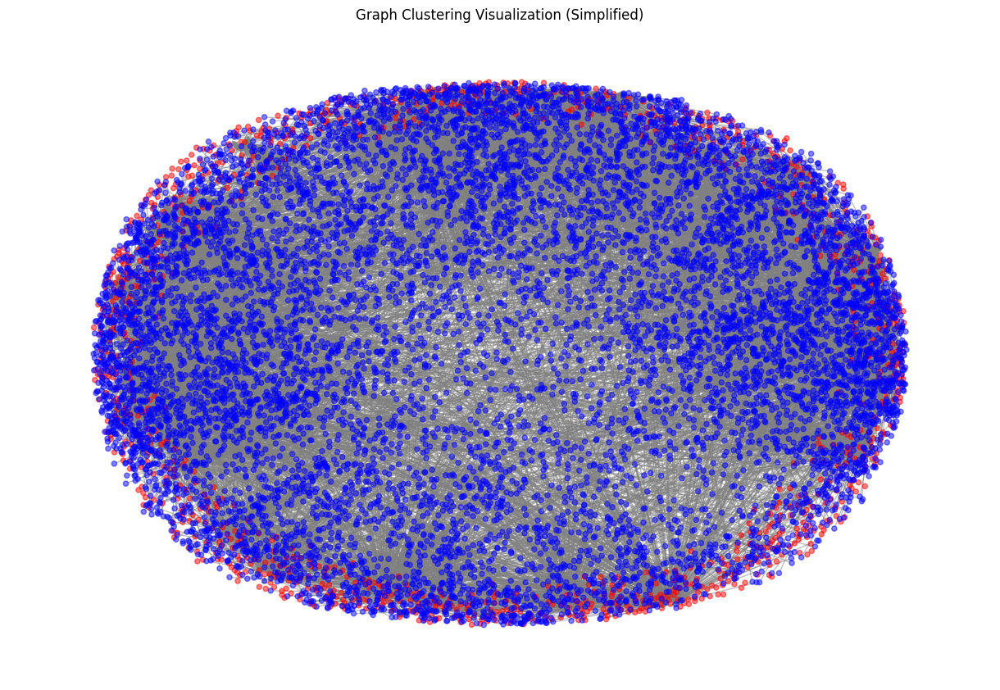

In [10]:
import matplotlib.pyplot as plt

# Ensure graph exists before plotting
if G and len(G.nodes) > 0:
    plt.figure(figsize=(12, 8))
    pos = nx.spring_layout(G)  # Spring layout for better visualization, it does not correspond to the actual position of the nodes!!!

    # Define node colors
    node_colors = ['red' if G.nodes[node]['type'] == 'seed' else 'blue' for node in G.nodes]

    # Draw the graph with much smaller nodes and no labels
    nx.draw(
        G, pos, with_labels=False, node_color=node_colors, node_size=20,  # Reduce node size
        edge_color='gray', arrows=True, alpha=0.5  # Make edges slightly transparent
    )

    plt.title("Graph Clustering Visualization (Simplified)")
    plt.show()
else:
    print("Graph is empty. Please reload or recreate the graph before plotting.")


In [11]:
overlap_nodes = []

# Identify overlapping nodes
for node in G.nodes:
    in_edges = list(G.in_edges(node))
    if len(in_edges) > 1:  # Node has multiple incoming edges
        overlap_nodes.append(node)

print(f"Found {len(overlap_nodes)} overlapping nodes.")


Found 37 overlapping nodes.


In [12]:
# Distribute energy for overlapping nodes
overlap_results = []

for node in overlap_nodes:
    in_edges = list(G.in_edges(node))
    total_energy = sum(G.nodes[src]['energy'] for src, _ in in_edges)

    for src, _ in in_edges:
        # Calculate overlap weight
        weight = G.nodes[src]['energy'] / total_energy
        overlap_results.append({
            'Node': node,
            'Seed': src,
            'Weight': weight,
            'Node Energy': G.nodes[node]['energy'],
            'Seed Energy': G.nodes[src]['energy']
        })

# Convert to DataFrame for easier analysis
import pandas as pd
overlap_df = pd.DataFrame(overlap_results)
print(overlap_df.head())


             Node            Seed    Weight  Node Energy  Seed Energy
0  (1439, 162, 0)  (1439, 154, 0)  0.011538  6113.748047   646.645996
1  (1439, 162, 0)  (1439, 154, 1)  0.011538  6113.748047   646.645996
2  (1439, 162, 0)  (1439, 154, 2)  0.011538  6113.748047   646.645996
3  (1439, 162, 0)  (1439, 154, 3)  0.011538  6113.748047   646.645996
4  (1439, 162, 0)  (1439, 154, 4)  0.011538  6113.748047   646.645996


### Showing clusters individually

In [13]:
# Convert to an undirected graph for finding connected components
undirected_G = G.to_undirected()

# Get the connected components (each is a separate cluster)
clusters = list(nx.connected_components(undirected_G))

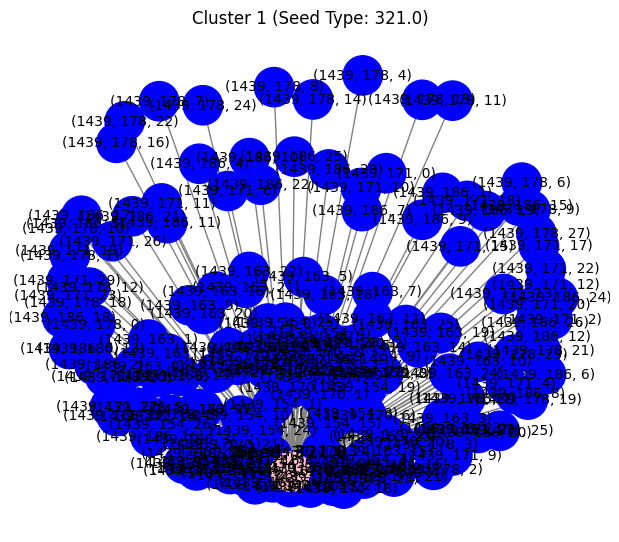

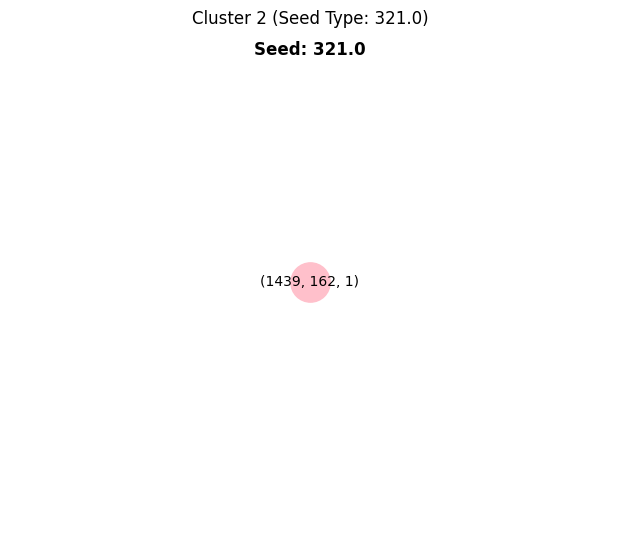

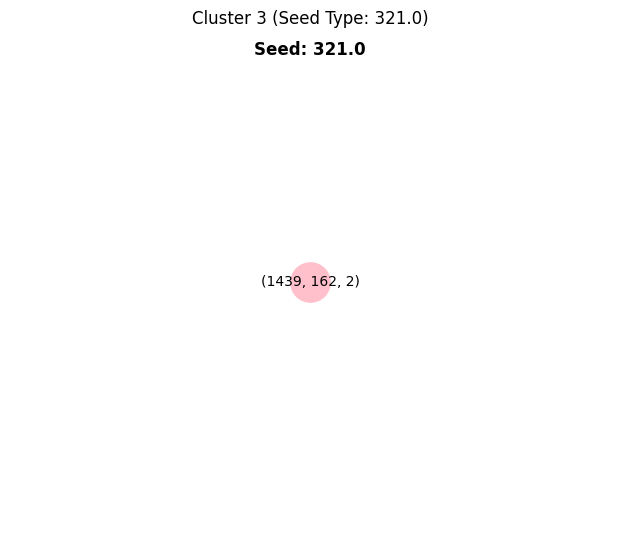

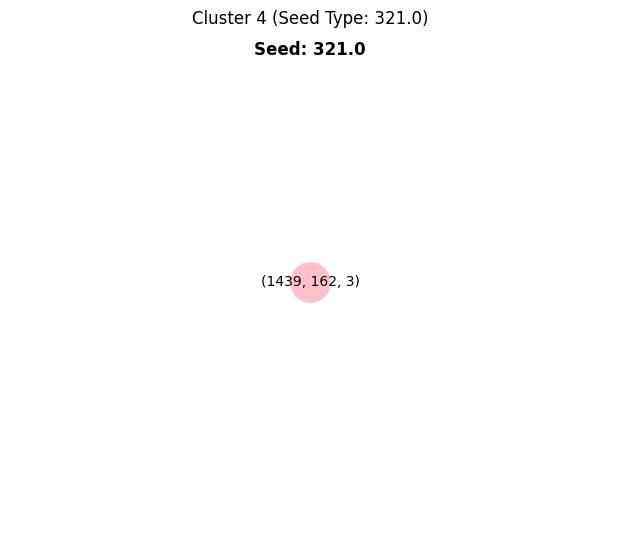

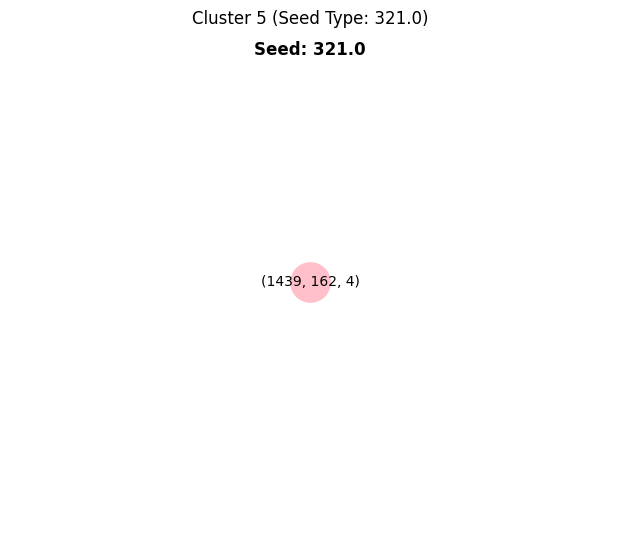

...

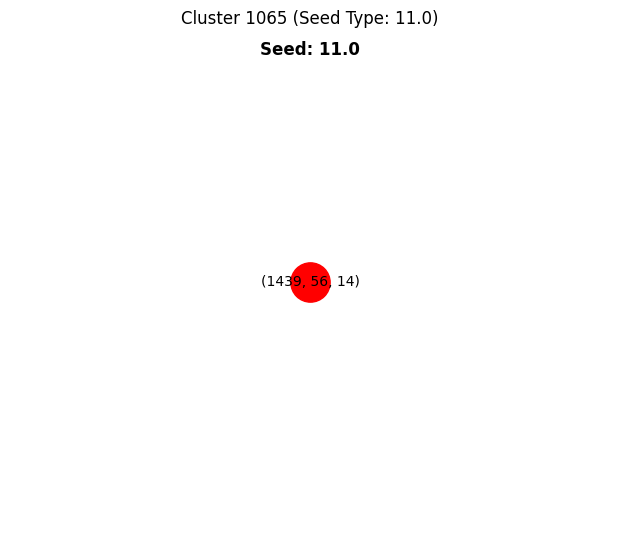

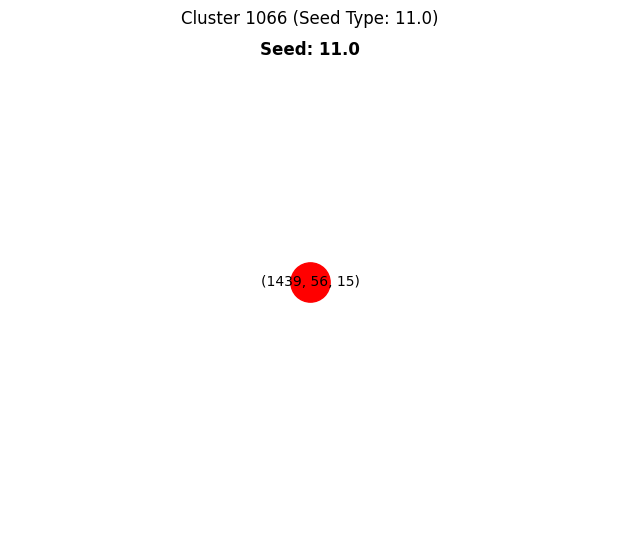

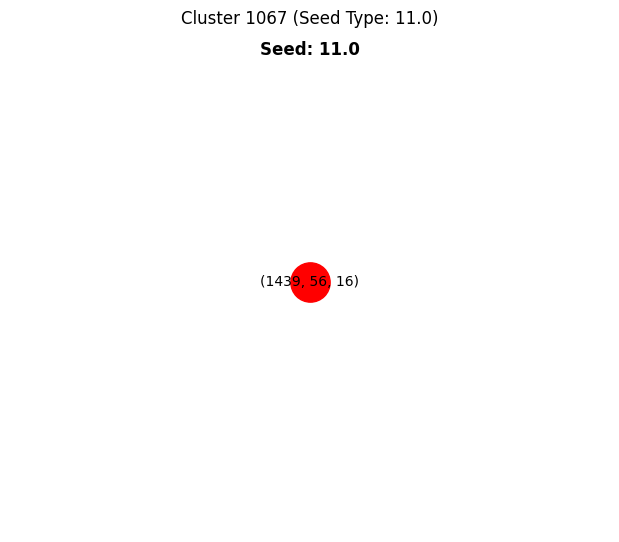

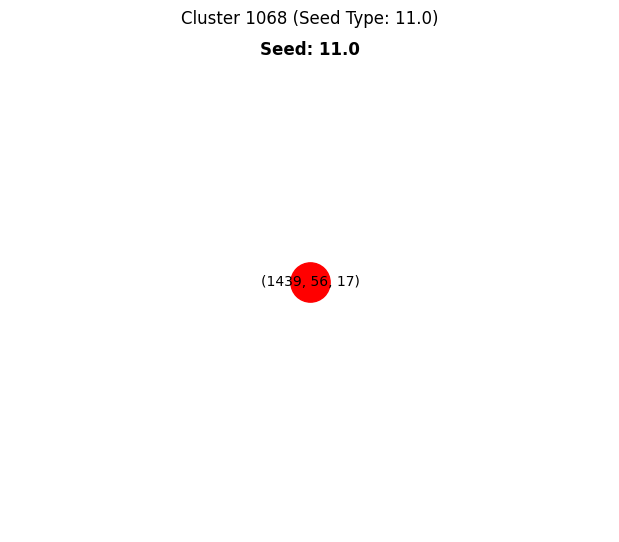

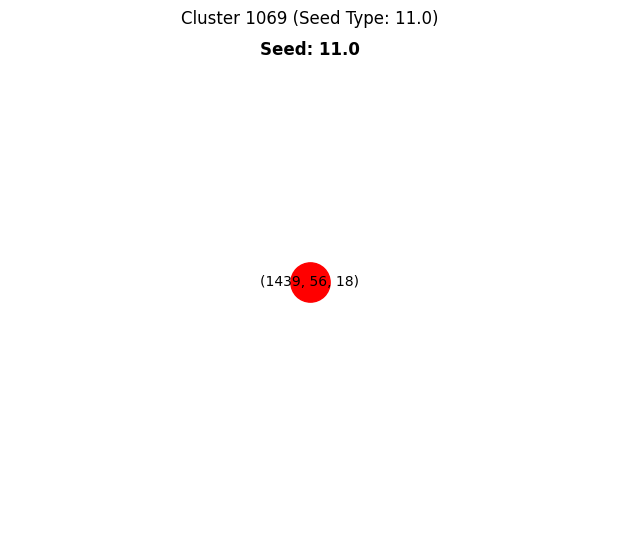

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-17-e062326bd6c3>", line 56, in <cell line: 0>
    plt.show()
  File "/usr/local/lib/python3.11/dist-packages/matplotlib/pyplot.py", line 614, in show
    return _get_backend_mod().show(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/matplotlib_inline/backend_inline.py", line 90, in show
    display(
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/display.py", line 320, in display
    format_dict, md_dict = format(obj, include=include, exclude=exclude)
                           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/IPython/core/formatters.py", line 180, in format
    data = formatter(obj)
           ^^^^^^^^^^^^^^
  File "<decorator-gen

TypeError: object of type 'NoneType' has no len()

In [17]:
import matplotlib.pyplot as plt
import networkx as nx

# Convert to an undirected graph for finding connected components
undirected_G = G.to_undirected()

# Get the connected components (each is a separate cluster)
clusters = list(nx.connected_components(undirected_G))

particle_colors = {
    22: "yellow",   # Photon
    11: "red",      # Electron
    -11: "orange",  # Positron
    211: "magenta",    # Pion +
    -211: "cyan",   # Pion -
    111: "purple",  # Pion neutral
    2212: "green",  # Proton
    321: "pink",    # Kaon +
    -321: "lightblue", # Kaon -
}

for idx, cluster_nodes in enumerate(clusters):
    subgraph = G.subgraph(cluster_nodes)

    # Find the seed in the cluster
    seed_node = None
    seed_mcid = None
    for node in subgraph.nodes:
        if subgraph.nodes[node]["type"] == "seed":
            seed_node = node
            seed_mcid = subgraph.nodes[node].get("MCID", "Unknown")  # Get particle type

    # Define layout and colors
    pos = nx.spring_layout(subgraph)
    node_colors = [
        particle_colors.get(subgraph.nodes[node].get("MCID"), "gray")  # Use color depending on MCID
        if subgraph.nodes[node]["type"] == "seed" else "blue"
        for node in subgraph.nodes
    ]

    # Draw the graph
    plt.figure(figsize=(6, 5))
    nx.draw(
        subgraph, pos, with_labels=True, node_color=node_colors,
        node_size=800, font_size=10, edge_color="gray"
    )

    # Add seed type in graph
    if seed_node:
        plt.text(
            pos[seed_node][0], pos[seed_node][1] + 0.05,
            f"Seed: {seed_mcid}", fontsize=12, color="black", ha="center", fontweight="bold"
        )

    plt.title(f"Cluster {idx + 1} (Seed Type: {seed_mcid})")
    plt.show()


### Getting a cluster dataset for the GNN analysis

In [ ]:
clusters[1]

In [14]:
seed_energy_contributions = []
print(len(clusters))
for idx, cluster_nodes in enumerate(clusters):
    subgraph = G.subgraph(cluster_nodes)

    # Find the seed in the cluster
    seed_node = None
    seed_mcid = None
    for node in subgraph.nodes:
        if subgraph.nodes[node]["type"] == "seed":
            seed_node = node
            seed_mcid = subgraph.nodes[node].get("MCID", "Unknown")
            seed_energy = subgraph.nodes[node]["energy"]

    if seed_node is None:
        continue  # Skip if no seed found

    # Compute total energy in the cluster
    total_energy = sum(subgraph.nodes[node]["energy"] for node in subgraph.nodes)

    # Compute photon energy contribution
    photon_energy = sum(
        subgraph.nodes[node]["energy"]
        for node in subgraph.nodes
        if subgraph.nodes[node].get("MCID") == 22
    )

    # Compute fraction of energy from photons
    photon_fraction = photon_energy / total_energy if total_energy > 0 else 0

    seed_energy_contributions.append({
        "Cluster": idx + 1,
        "Seed Node": seed_node,
        "Seed MCID": seed_mcid,
        "Seed Energy": seed_energy,
        "Total Cluster Energy": total_energy,
        "Photon Energy": photon_energy,
        "Photon Energy Fraction": photon_fraction
    })

# Convert results into a DataFrame for better visualization
import pandas as pd
df_seeds = pd.DataFrame(seed_energy_contributions)
print("PHOTON SEEDS")
count = 0
for seed in df_seeds.iterrows():
    if seed[1]['Seed MCID'] == 22:
      count = count + 1
      print(seed)



1110
PHOTON SEEDS
(30, Cluster                               31
Seed Node                 (1439, 258, 0)
Seed MCID                           22.0
Seed Energy                  5116.319824
Total Cluster Energy       220534.374453
Photon Energy              105522.897125
Photon Energy Fraction          0.478487
Name: 30, dtype: object)
(31, Cluster                               32
Seed Node                 (1439, 258, 1)
Seed MCID                           22.0
Seed Energy                  5116.319824
Total Cluster Energy         5116.319824
Photon Energy                5116.319824
Photon Energy Fraction               1.0
Name: 31, dtype: object)
(32, Cluster                               33
Seed Node                 (1439, 258, 2)
Seed MCID                           22.0
Seed Energy                  5116.319824
Total Cluster Energy         5116.319824
Photon Energy                5116.319824
Photon Energy Fraction               1.0
Name: 32, dtype: object)
(33, Cluster                   

In [15]:
print(f"Total of clusters with photon seed:{count}")

Total of clusters with photon seed:240


In [16]:
print("NON PHOTON SEEDS")
for seed in df_seeds.iterrows():
    if seed[1]['Seed MCID'] != 22:
      print(seed)

Se han truncado las últimas 5000 líneas del flujo de salida.
(305, Cluster                              306
Seed Node                 (1439, 244, 5)
Seed MCID                          211.0
Seed Energy                  1813.478027
Total Cluster Energy         1813.478027
Photon Energy                        0.0
Photon Energy Fraction               0.0
Name: 305, dtype: object)
(306, Cluster                              307
Seed Node                 (1439, 244, 6)
Seed MCID                          211.0
Seed Energy                  1813.478027
Total Cluster Energy         1813.478027
Photon Energy                        0.0
Photon Energy Fraction               0.0
Name: 306, dtype: object)
(307, Cluster                              308
Seed Node                 (1439, 244, 7)
Seed MCID                          211.0
Seed Energy                  1813.478027
Total Cluster Energy         1813.478027
Photon Energy                        0.0
Photon Energy Fraction               0.0
Name: 30

In [17]:
undirected_G = G.to_undirected()  # Convert to undirected graph
clusters = list(nx.connected_components(undirected_G))  # Extract connected components


In [18]:
all_cluster_nodes = [node for cluster in clusters for node in cluster]
print(f"Total unique nodes: {len(set(all_cluster_nodes))}, Total assigned nodes: {len(all_cluster_nodes)}")


Total unique nodes: 10770, Total assigned nodes: 10770


### CHECK PARTICLES THAT REACH EVERY CLUSTER

In [19]:
import pandas as pd

# store in which cluesters each particles deposits energy
particle_energy_distribution = {}

for idx, cluster_nodes in enumerate(clusters):
    subgraph = G.subgraph(cluster_nodes)

    for node in subgraph.nodes:
        mcid = subgraph.nodes[node].get("MCID", None)
        energy = subgraph.nodes[node].get("energy", 0)

        if mcid is not None:
            if mcid not in particle_energy_distribution:
                particle_energy_distribution[mcid] = []
            particle_energy_distribution[mcid].append((idx, energy))  # store cluster and energy

# convert to dataframe
particle_cluster_df = pd.DataFrame([
    {"Particle MCID": mcid, "Cluster ID": cluster_id, "Deposited Energy": energy}
    for mcid, clusters in particle_energy_distribution.items() for cluster_id, energy in clusters
])

particle_counts = particle_cluster_df.groupby(["Cluster ID", "Particle MCID"]).size().reset_index(name="Count")



PLOT

<Figure size 1200x600 with 0 Axes>

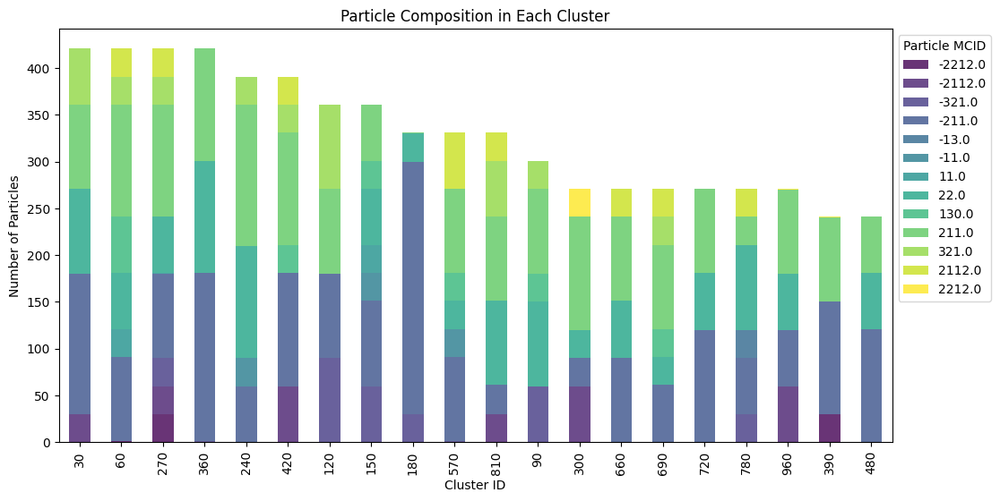

In [20]:

pivot_table = particle_counts.pivot(index="Cluster ID", columns="Particle MCID", values="Count").fillna(0)

# Reduce the number of clusters for better visualization (top 20 by total count)
top_clusters = particle_counts.groupby("Cluster ID")["Count"].sum().nlargest(20).index
filtered_pivot_table = pivot_table.loc[top_clusters]


plt.figure(figsize=(12, 6))
filtered_pivot_table.plot(kind="bar", stacked=True, figsize=(12, 6), colormap="viridis", alpha=0.8)

plt.xlabel("Cluster ID")
plt.ylabel("Number of Particles")
plt.title("Particle Composition in Each Cluster")
plt.legend(title="Particle MCID", bbox_to_anchor=(1, 1))
plt.xticks(rotation=90)
plt.show()



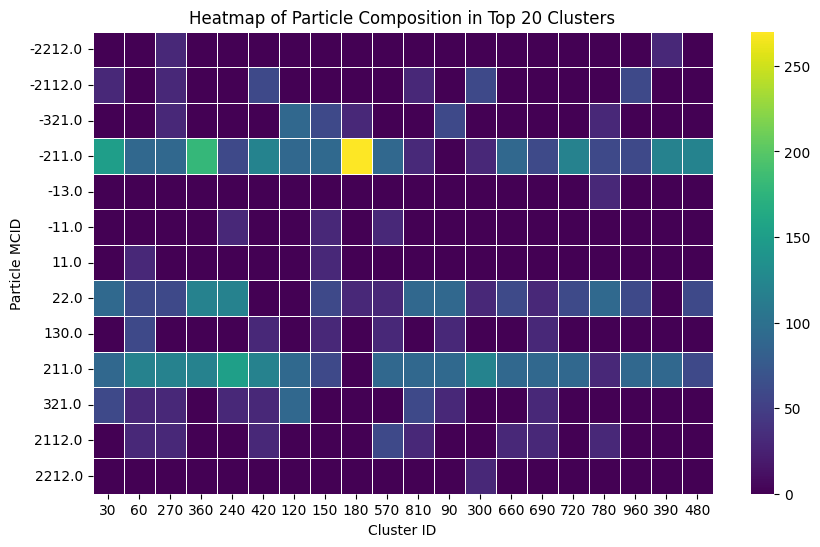

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.heatmap(filtered_pivot_table.T, cmap="viridis", annot=False, cbar=True, linewidths=0.5)

plt.xlabel("Cluster ID")
plt.ylabel("Particle MCID")
plt.title("Heatmap of Particle Composition in Top 20 Clusters")

plt.show()



In [22]:
# Encontrar el cluster con la mayor energía depositada por cada partícula
dominant_clusters = particle_cluster_df.groupby("Particle MCID").apply(
    lambda x: x.loc[x["Deposited Energy"].idxmax()]
).reset_index(drop=True)

print(dominant_clusters)


    Particle MCID  Cluster ID  Deposited Energy
0         -2212.0        60.0       4666.155762
1         -2112.0        30.0       2212.055908
2          -321.0       120.0       2086.187988
3          -211.0       150.0       2511.516113
4           -13.0       780.0         -5.092000
5           -11.0       240.0       1400.515991
6            11.0       270.0       1850.576050
7            22.0        30.0       5116.319824
8           130.0        90.0       1675.637939
9           211.0        90.0       3140.548096
10          321.0         0.0       6113.748047
11         2112.0       600.0        437.976013
12         2212.0       390.0       1138.073975


<ipython-input-22-3fecb5f7f7a2>:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  dominant_clusters = particle_cluster_df.groupby("Particle MCID").apply(


## ADDING UP ENERGY FOR EACH CLUSTER

In [23]:
reconstructed_energy = {}

for idx, cluster_nodes in enumerate(clusters):
    subgraph = G.subgraph(cluster_nodes)

    # add up energy of the entire cluster
    total_cluster_energy = sum(subgraph.nodes[node]["energy"] for node in subgraph.nodes)

    reconstructed_energy[idx] = total_cluster_energy

# convert to dataframe
df_reconstructed_energy = pd.DataFrame.from_dict(reconstructed_energy, orient="index", columns=["Reconstructed Energy"])
df_reconstructed_energy.index.name = "Cluster ID"

print(df_reconstructed_energy)


            Reconstructed Energy
Cluster ID                      
0                   62160.587551
1                    6113.748047
2                    6113.748047
3                    6113.748047
4                    6113.748047
...                          ...
1105                  194.832001
1106                  194.832001
1107                  194.832001
1108                  194.832001
1109                  194.832001

[1110 rows x 1 columns]


In [24]:
print(f"Total number of events in the dataset: {len(filtered_df)}")
total_photons = filtered_df[filtered_df["MCID"] == 22]
print(f"Total number of photons in the dataset: {len(total_photons)}")


Total number of events in the dataset: 13615740
Total number of photons in the dataset: 2173020


In [25]:
energy_threshold = 50  # Current threshold

high_energy_photons = filtered_df[(filtered_df["MCID"] == 22) & (filtered_df["digitE"] > energy_threshold)]
print(f"Photons above {energy_threshold} MeV: {len(high_energy_photons)}")


Photons above 50 MeV: 849150


In [26]:
print(f"Total rows (particles) in the dataset: {len(filtered_df)}")
print(f"Total unique event IDs: {filtered_df['evtnum'].nunique()}")
photon_seed_clusters = filtered_df[filtered_df["MCID"] == 22]
print(f"Total photons in the event: {len(photon_seed_clusters)}")


Total rows (particles) in the dataset: 13615740
Total unique event IDs: 3538
Total photons in the event: 2173020


### finding clusters with x% of photon energy

In [27]:
high_photon_clusters = df_seeds[df_seeds["Photon Energy Fraction"] >= 0.5]
high_photon_clusters_2 = high_photon_clusters[high_photon_clusters["Photon Energy Fraction"] < 1]
high_photon_clusters_2

,Cluster,Seed Node,Seed MCID,Seed Energy,Total Cluster Energy,Photon Energy,Photon Energy Fraction
0,1,"(1439, 162, 0)",321.0,6113.748047,62160.587551,45774.599304,0.736393
210,211,"(1439, 84, 0)",22.0,2443.719971,9542.320053,7208.919975,0.755468
330,331,"(1439, 324, 0)",22.0,1728.219971,30544.419884,23209.119705,0.759848
780,781,"(1439, 353, 0)",22.0,472.635986,37151.956274,19839.316265,0.534005
930,931,"(1439, 273, 0)",211.0,319.480011,6113.139774,4928.639789,0.806237
990,991,"(1439, 282, 0)",-2212.0,295.596008,7508.315845,6087.779846,0.810805
1080,1081,"(1439, 2, 0)",-321.0,194.832001,1123.151994,603.599997,0.537416


### Getting data for GNN analysis

In [28]:
import pandas as pd

# Convert nested dictionary into a flat list
data_list = []
for cluster_id, nodes in clustered_nodes.items():
    for node in nodes:
        node["cluster_id"] = cluster_id  # Ensure cluster ID is included
        data_list.append(node)

# Create DataFrame
clustered_nodes_df = pd.DataFrame(data_list)

# Display first rows
print(clustered_nodes_df.head())


           node_id      energy    MCID      type   row  column  clusterId  \
0  (1439, 186, 12)   65.010002  -211.0  neighbor  39.0     0.0          0   
1  (1439, 154, 23)  646.645996    22.0  neighbor  35.0     0.0          0   
2   (1439, 178, 8)   25.740000 -2112.0  neighbor  38.0     0.0          0   
3  (1439, 186, 21)   65.010002  -211.0  neighbor  39.0     0.0          0   
4  (1439, 178, 17)   25.740000 -2112.0  neighbor  38.0     0.0          0   

   cluster_id  
0           0  
1           0  
2           0  
3           0  
4           0  


In [29]:
clustered_nodes_df

,node_id,energy,MCID,type,row,column,clusterId,cluster_id
0,"(1439, 186, 12)",65.010002,-211.0,neighbor,39.0,0.0,0,0
1,"(1439, 154, 23)",646.645996,22.0,neighbor,35.0,0.0,0,0
2,"(1439, 178, 8)",25.740000,-2112.0,neighbor,38.0,0.0,0,0
3,"(1439, 186, 21)",65.010002,-211.0,neighbor,39.0,0.0,0,0
4,"(1439, 178, 17)",25.740000,-2112.0,neighbor,38.0,0.0,0,0
...,...,...,...,...,...,...,...,...
10765,"(1439, 2, 25)",194.832001,-321.0,seed,13.0,0.0,1105,1105
10766,"(1439, 2, 26)",194.832001,-321.0,seed,13.0,0.0,1106,1106
10767,"(1439, 2, 27)",194.832001,-321.0,seed,13.0,0.0,1107,1107
10768,"(1439, 2, 28)",194.832001,-321.0,seed,13.0,0.0,1108,1108


In [64]:
def find_small_clusters(G, max_size=50):
    """
    Finds connected components (clusters) in G that have fewer than `max_size` nodes.
    Returns a list of (cluster_id, cluster_nodes).
    """
    # Convert to undirected for connected components (if G is not already undirected)
    undirected_G = G.to_undirected()

    # Get all connected components
    components = list(nx.connected_components(undirected_G))

    # Enumerate each component, and filter by size
    small_clusters = []
    for cluster_id, nodes in enumerate(components):
        if len(nodes) < max_size and len(nodes) > 1:
            # Add (cluster_id, the set of nodes) to the results
            small_clusters.append((cluster_id, nodes))

    return small_clusters

In [71]:
result = find_small_clusters(G, max_size=150)
for cid, c_nodes in result:
     print(f"Cluster ID: {cid}, Size: {len(c_nodes)}, Nodes: {c_nodes}")

Cluster ID: 600, Size: 121, Nodes: {(1439, 166, 6), (1439, 158, 2), (1439, 157, 15), (1439, 164, 8), (1439, 166, 27), (1439, 157, 24), (1439, 164, 29), (1439, 158, 4), (1439, 157, 8), (1439, 164, 1), (1439, 166, 20), (1439, 165, 0), (1439, 157, 17), (1439, 166, 29), (1439, 157, 26), (1439, 158, 25), (1439, 164, 22), (1439, 157, 1), (1439, 166, 13), (1439, 157, 10), (1439, 166, 22), (1439, 157, 19), (1439, 158, 18), (1439, 157, 28), (1439, 158, 27), (1439, 164, 15), (1439, 164, 24), (1439, 157, 3), (1439, 166, 15), (1439, 157, 12), (1439, 158, 11), (1439, 166, 24), (1439, 157, 21), (1439, 158, 20), (1439, 158, 29), (1439, 164, 17), (1439, 164, 26), (1439, 166, 8), (1439, 157, 5), (1439, 166, 17), (1439, 157, 14), (1439, 158, 13), (1439, 166, 26), (1439, 157, 23), (1439, 158, 22), (1439, 164, 10), (1439, 164, 19), (1439, 164, 28), (1439, 166, 1), (1439, 166, 10), (1439, 157, 7), (1439, 158, 6), (1439, 166, 19), (1439, 157, 16), (1439, 158, 15), (1439, 166, 28), (1439, 157, 25), (1439, 15

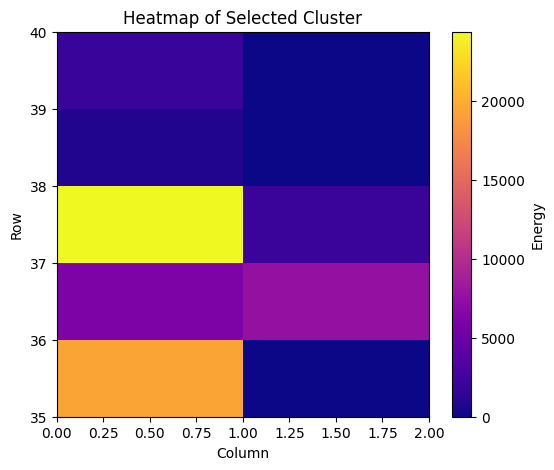

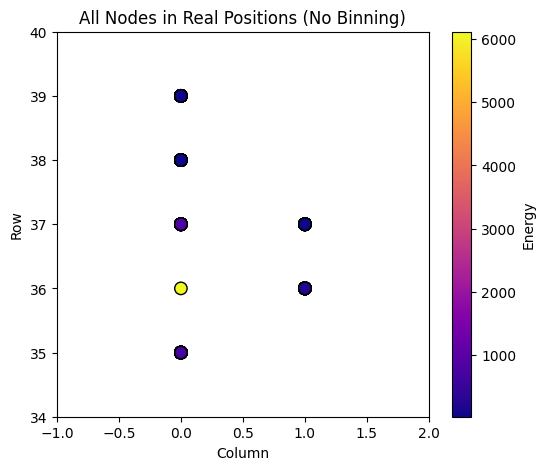

In [77]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# 1) Convert to undirected for connected components
undirected_G = G.to_undirected()

# 2) Identify clusters
clusters = list(nx.connected_components(undirected_G))
if not clusters:
    print("No clusters found.")
else:
    # Select the first cluster
    selected_cluster_nodes = list(clusters[0])
    subgraph = G.subgraph(selected_cluster_nodes)

    # Extract row, column, energy for each node
    all_rows = []
    all_cols = []
    all_energies = []

    for node in subgraph.nodes:
        r = int(subgraph.nodes[node]["row"])
        c = int(subgraph.nodes[node]["column"])
        e = float(subgraph.nodes[node]["energy"])
        all_rows.append(r)
        all_cols.append(c)
        all_energies.append(e)

    # ------------------------------
    # FIGURE 1: Heatmap
    # ------------------------------
    # Determine bounding box
    min_row, max_row = min(all_rows), max(all_rows)
    min_col, max_col = min(all_cols), max(all_cols)

    num_rows = (max_row - min_row) + 1
    num_cols = (max_col - min_col) + 1

    # Create 2D array for energies
    heatmap = np.zeros((num_rows, num_cols))

    # Fill it, offsetting by min_row / min_col
    for (r, c, e) in zip(all_rows, all_cols, all_energies):
        row_idx = r - min_row
        col_idx = c - min_col
        heatmap[row_idx, col_idx] += e

    plt.figure(figsize=(6, 5))
    plt.imshow(
        heatmap,
        origin="lower",
        aspect="auto",
        cmap="plasma",
        vmin=0,
        vmax=heatmap.max() if heatmap.max() > 0 else 1.0,
        extent=[min_col, max_col + 1, min_row, max_row + 1]
    )
    plt.colorbar(label="Energy")
    plt.xlabel("Column")
    plt.ylabel("Row")
    plt.title("Heatmap of Selected Cluster")
    plt.show()

    # ------------------------------
    # FIGURE 2: Scatter all nodes at real positions
    # ------------------------------
    plt.figure(figsize=(6, 5))
    # Scatter or plot all nodes at (column, row) without alpha
    # Here we color them by energy for convenience (you can pick any coloring)
    scatter = plt.scatter(
        all_cols,
        all_rows,
        c=all_energies,
        cmap="plasma",
        s=80,
        edgecolors="black",
        alpha=1.0  # fully opaque
    )
    plt.colorbar(scatter, label="Energy")
    plt.xlabel("Column")
    plt.ylabel("Row")
    plt.title("All Nodes in Real Positions (No Binning)")

    # Ensure the axis range includes all nodes comfortably
    plt.xlim(min_col - 1, max_col + 1)
    plt.ylim(min_row - 1, max_row + 1)

    plt.show()


In [79]:
print("Index is unique?", particles.index.is_unique)

Index is unique? True


In [ ]:
particles = particles.reset_index(drop=True)

